In [1]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK./root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1
# /content/labels_with_dont_care
import kagglehub
klemenko_kitti_dataset_path = kagglehub.dataset_download('klemenko/kitti-dataset')

print('Data source import complete.')




100%|██████████| 22.5G/22.5G [04:26<00:00, 90.5MB/s]

Extracting files...


Data source import complete.


In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 913.6/913.6 kB 27.8 MB/s eta 0:00:00


In [3]:
# YOLOv8 Object Detection Training Script for KITTI Dataset
import os
import shutil
import yaml
import random
import torch
import numpy as np
from pathlib import Path
from PIL import Image
from sklearn.model_selection import train_test_split
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
import torch
from pathlib import Path

KITTI_BASE_DIR = '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1'
"""str: The base directory where the KITTI dataset is located."""

IMAGE_DIR = Path(KITTI_BASE_DIR) / 'data_object_image_2' / 'training' / 'image_2'
"""Path: Directory containing KITTI training images."""

LABEL_DIR = Path(KITTI_BASE_DIR) / 'data_object_label_2' / 'training' / 'label_2'
"""Path: Directory containing KITTI training labels."""

TRAIN_DIR = Path(KITTI_BASE_DIR)/'train'
"""Path: Directory where training images and labels will be stored in YOLOv5 format."""

VALID_DIR = Path(KITTI_BASE_DIR)/'valid'
"""Path: Directory where validation images and labels will be stored in YOLOv5 format."""

LABELS_DIR = Path(KITTI_BASE_DIR)/'labels_with_dont_care'
"""Path: Directory where YOLOv5-formatted labels will be stored."""

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
list of str: List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

# YOLOv5 model configuration (YOLOv5 uses .yaml files for model config)
MODEL_ARCH = 'yolov5l.yaml'  # Changed from 'yolov5s.yaml' to 'yolov5l.yaml'
"""str: The YOLOv5 model configuration file to use."""

EPOCHS = 50
"""int: Number of epochs for training. Adjust this value based on dataset size and desired training time."""

BATCH_SIZE = 16
"""int: Batch size used during training. Adjust based on GPU memory constraints."""

IMG_SIZE = 640
"""int: The size (height and width) of the input images for the model."""

CONFIDENCE_THRESHOLD = 0.25
"""float: The confidence threshold for predictions during validation and testing."""

PROJECT_NAME = 'YOLOv5-KITTI'
"""str: The name of the project folder where YOLOv5 results will be saved."""

EXPERIMENT_NAME = 'exp1'
"""str: The name of the experiment folder within the project directory to store this run's results."""

device = 'cuda' if torch.cuda.is_available() else 'cpu'
"""str: The device to use for training and inference, defaults to GPU if available."""

print(f"Using device: {device}")


Using device: cuda


In [5]:
from PIL import Image
from pathlib import Path

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

CLAZZ_NUMBERS = {name: idx for idx, name in enumerate(CLASSES)}
"""
dict: A mapping from class names to numeric labels.
The numeric labels are used by YOLO for class indices.
"""

def convert_bbox_to_yolo(bbox, size):
    """
    Convert KITTI bounding box coordinates to YOLO format.

    Args:
        bbox (tuple of float): Bounding box coordinates in the format (left, right, top, bottom).
        size (tuple of int): Image size as (width, height).

    Returns:
        tuple of float: YOLO-formatted bounding box as (x_center, y_center, width, height) normalized by image size.
    """
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    x_center = (bbox[0] + bbox[1]) / 2.0
    y_center = (bbox[2] + bbox[3]) / 2.0
    width = bbox[1] - bbox[0]
    height = bbox[3] - bbox[2]
    x_center *= dw
    width *= dw
    y_center *= dh
    height *= dh
    return x_center, y_center, width, height

def parse_kitti_label_file(lbl_path, img_path):
    """
    Parse a KITTI label file and convert the bounding boxes to YOLOv5 format.

    Args:
        lbl_path (Path): Path to the KITTI label file (in KITTI text format).
        img_path (Path): Path to the corresponding image file.

    Returns:
        list of tuple: A list of YOLOv5-formatted bounding boxes. Each element is
        (class_idx, x_center, y_center, width, height).
    """
    with open(lbl_path, 'r', encoding='utf-8') as file:
        lines = file.read().strip().split('\n')

    yolo_labels = []
    if not img_path.exists():
        # If the image doesn't exist, skip processing labels
        return yolo_labels

    img_size = Image.open(img_path).size  # (width, height)

    for line in lines:
        parts = line.split()
        clazz = parts[0]
        if clazz not in CLAZZ_NUMBERS:
            # Skip classes not in our mapping
            continue

        # KITTI format:
        # type, truncated, occluded, alpha, bbox_left, bbox_top, bbox_right, bbox_bottom, ...
        # Indices:  0    ,    1     ,   2     ,   3  ,    4     ,    5    ,     6     ,      7    ...
        # Example: Car 0.00 0 1.57 148.00 174.00 350.00 325.00 ...
        # The bounding box coordinates: left = parts[4], top = parts[5], right = parts[6], bottom = parts[7]
        bbox_left = float(parts[4])
        bbox_top = float(parts[5])
        bbox_right = float(parts[6])
        bbox_bottom = float(parts[7])
        bbox = (bbox_left, bbox_right, bbox_top, bbox_bottom)

        # Convert bounding box to YOLO format (normalized)
        x_center, y_center, width, height = convert_bbox_to_yolo(bbox, img_size)
        clazz_number = CLAZZ_NUMBERS[clazz]

        # YOLO format: class x_center y_center width height
        yolo_labels.append((clazz_number, x_center, y_center, width, height))

    return yolo_labels



In [6]:
if not LABELS_DIR.exists():
    LABELS_DIR.mkdir()

image_paths = sorted(list(IMAGE_DIR.glob('*.png')))
label_paths = sorted(list(LABEL_DIR.glob('*.txt')))

for img_path in image_paths:
    lbl_path = LABEL_DIR / f"{img_path.stem}.txt"
    if lbl_path.exists():
        yolo_labels = parse_kitti_label_file(lbl_path, img_path)
        yolo_label_path = LABELS_DIR / f"{img_path.stem}.txt"
        with open(yolo_label_path, 'w', encoding='utf-8') as lf:
            for lbl in yolo_labels:
                lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

print("YOLO format labels have been generated in:", LABELS_DIR.resolve())

YOLO format labels have been generated in: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/labels_with_dont_care


In [7]:
labels_for_images = [(img_path, LABELS_DIR / f"{img_path.stem}.txt")
                     for img_path in image_paths
                     if (LABELS_DIR / f"{img_path.stem}.txt").exists()]

train_pairs, valid_pairs = train_test_split(
    labels_for_images,
    test_size=0.1,
    random_state=42,
    shuffle=True
)
print(f"Training samples: {len(train_pairs)}, Validation samples: {len(valid_pairs)}")

# Create directories for YOLO data structure:
for folder in [TRAIN_DIR, VALID_DIR]:
    if folder.exists():
        shutil.rmtree(folder)
    folder.mkdir()
    (folder / 'images').mkdir()
    (folder / 'labels').mkdir()

for img_path, lbl_path in train_pairs:
    shutil.copy(img_path, TRAIN_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, TRAIN_DIR / 'labels' / lbl_path.name)

for img_path, lbl_path in valid_pairs:
    shutil.copy(img_path, VALID_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, VALID_DIR / 'labels' / lbl_path.name)

print(f"Training data copied to {TRAIN_DIR / 'images'} and {TRAIN_DIR / 'labels'}")
print(f"Validation data copied to {VALID_DIR / 'images'} and {VALID_DIR / 'labels'}")

Training samples: 6732, Validation samples: 749
Training data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels
Validation data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels


In [8]:
import yaml
from pathlib import Path

# Define your class names
CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]  # Replace with your actual class names

# Update with the actual paths where you moved your dataset
# These should match the paths in cell 52
TRAIN_DIR = Path(KITTI_BASE_DIR) / 'train' / 'images'
VALID_DIR = Path(KITTI_BASE_DIR) / 'valid' / 'images'

# Define the path for the data.yaml file
DATA_CONFIG = '/content/data.yaml'

# Prepare the data configuration dictionary
data_config = {
    'train': str(TRAIN_DIR.resolve()),  # Absolute path to train images
    'val': str(VALID_DIR.resolve()),    # Absolute path to validation images
    'nc': len(CLASSES),                 # Number of classes
    'names': CLASSES                    # List of class names
}

# Write the data configuration to the data.yaml file
with open(DATA_CONFIG, 'w', encoding='utf-8') as f:
    yaml.dump(data_config, f, default_flow_style=False)

# Output the content of the generated data.yaml file
print("data.yaml file created with content:")
print(data_config)

data.yaml file created with content:
{'train': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images', 'val': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images', 'nc': 9, 'names': ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']}


In [9]:

!pip install yolov5

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.5/953.5 kB 27.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.2/139.2 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 417.5/417.5 kB 31.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.5/81.5 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 18.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.4/112.4 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 105.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.2/84.2 kB 4.9 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=dd5ec137559686c7cc3e6eaf70d0cb96380b33cae8055943b23e324e7769ff24
  Stored in dir

In [10]:
# Clone the YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git

# Install dependencies
!pip install -r yolov5/requirements.txt

# Navigate to the repository
%cd yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 17265, done.
remote: Total 17265 (delta 0), reused 0 (delta 0), pack-reused 17265 (from 1)
Receiving objects: 100% (17265/17265), 16.10 MiB | 17.43 MiB/s, done.
Resolving deltas: 100% (11861/11861), done.
/content/yolov5


In [11]:
import torch
torch.cuda.empty_cache()  # Clear cached memory


In [12]:
!nvidia-smi


Mon Jan 27 06:23:31 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P8               9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [13]:
!kill -9 <PID>


/bin/bash: -c: line 1: syntax error near unexpected token `newline'
/bin/bash: -c: line 1: `kill -9 <PID>'


In [15]:

from ultralytics import YOLO
import torch
import os

# Define configuration
MODEL_ARCH = 'yolov5l'  # YOLOv5 large model
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the training parameters
DATA_CONFIG = '/content/data.yaml'  # Path to the data.yaml
EPOCHS = 50  # Reduce epochs to 30 for faster training
BATCH_SIZE = 16  # Keep batch size moderate to fit in GPU memory
IMG_SIZE = 512  # Reduce image size from 640 to 512 to save computation
CONFIDENCE_THRESHOLD = 0.25  # Confidence threshold for validation

PROJECT_NAME = 'YOLOv5-KITTI'  # Project folder name
EXPERIMENT_NAME = 'exp1'  # Experiment name

# Path to weights
weights_dir = f'{PROJECT_NAME}/{EXPERIMENT_NAME}/weights'
last_weights_path = os.path.join(weights_dir, 'last.pt')

# Check if a checkpoint exists
resume_training = os.path.exists(last_weights_path)

# Initialize the model
if resume_training:
    print(f"Resuming training from checkpoint: {last_weights_path}")
    model = YOLO(last_weights_path).to(device)  # Resume from the last checkpoint
else:
    print(f"Starting fresh training with model: {MODEL_ARCH}")
    model = YOLO(f'{MODEL_ARCH}.pt').to(device)  # Start fresh training

# Train the model
try:
    train_results = model.train(
        data=DATA_CONFIG,
        epochs=EPOCHS,
        batch=BATCH_SIZE,
        imgsz=IMG_SIZE,
        project=PROJECT_NAME,
        name=EXPERIMENT_NAME,
        device=device,
        save_period=5,  # Save checkpoints every 5 epochs
        exist_ok=True  # Avoid overwriting existing experiments
    )
    print("\nTraining completed!\n")

except Exception as e:
    print(f"\nTraining interrupted due to: {e}\n")
    print("Attempting to save progress...")
    # Save the current model state
    if hasattr(model, 'save'):
        model.save(last_weights_path)
        print(f"Progress saved at {last_weights_path}")

# Summary of training
print(f"Project directory: {PROJECT_NAME}/{EXPERIMENT_NAME}")
if resume_training:
    print(f"Resumed from checkpoint: {last_weights_path}")
else:
    print("Training started from scratch.")


Starting fresh training with model: yolov5l
PRO TIP 💡 Replace 'model=yolov5l.pt' with new 'model=yolov5lu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

Ultralytics 8.3.68 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5l.pt, data=/content/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=5, cache=False, device=cuda, workers=8, project=YOLOv5-KITTI, name=exp1, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=Fal

train: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels.cache... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]


Plotting labels to YOLOv5-KITTI/exp1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to YOLOv5-KITTI/exp1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      8.84G      1.259       1.09      1.047        245        512: 100%|██████████| 421/421 [04:11<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:15<00:00,  1.52it/s]

                   all        749       5425      0.546      0.417      0.447      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      8.77G      1.264      0.949      1.062        158        512: 100%|██████████| 421/421 [03:54<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.71it/s]


                   all        749       5425      0.739      0.377      0.485      0.291

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      9.08G      1.248     0.9136      1.059        125        512: 100%|██████████| 421/421 [03:49<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.80it/s]


                   all        749       5425      0.661      0.415      0.499      0.302

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      8.77G      1.224     0.8791      1.045        174        512: 100%|██████████| 421/421 [03:46<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.73it/s]


                   all        749       5425      0.775      0.413      0.501      0.297

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      9.08G      1.186     0.8346      1.028        158        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]


                   all        749       5425       0.72      0.466      0.568      0.348

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      9.06G      1.153     0.7914      1.015        195        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.72it/s]


                   all        749       5425      0.611      0.526      0.564       0.35

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      9.05G      1.131      0.767      1.007        196        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.74it/s]


                   all        749       5425      0.614      0.575      0.613      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      8.85G      1.103     0.7357     0.9972        160        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.82it/s]


                   all        749       5425      0.753       0.55      0.643      0.405

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      9.03G      1.084     0.7198     0.9898        179        512: 100%|██████████| 421/421 [03:51<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.69it/s]


                   all        749       5425        0.7      0.571      0.641      0.405

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       9.1G      1.067     0.6992     0.9822        201        512: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.90it/s]


                   all        749       5425      0.638      0.594       0.64      0.419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      9.05G      1.053     0.6878     0.9731        194        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.95it/s]


                   all        749       5425      0.703      0.627      0.687      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      9.06G      1.038       0.67     0.9715        138        512: 100%|██████████| 421/421 [03:53<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.74it/s]


                   all        749       5425      0.734      0.627      0.685      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      9.08G      1.024     0.6544     0.9653        181        512: 100%|██████████| 421/421 [03:53<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.72it/s]


                   all        749       5425      0.738      0.628      0.692      0.458

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      9.05G      1.004     0.6357     0.9596        155        512: 100%|██████████| 421/421 [03:53<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]


                   all        749       5425      0.717      0.648        0.7      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      8.98G     0.9992     0.6302     0.9566        107        512: 100%|██████████| 421/421 [03:53<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.80it/s]


                   all        749       5425      0.756       0.66      0.732      0.483

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      9.06G     0.9802     0.6165     0.9499        153        512: 100%|██████████| 421/421 [03:52<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.74it/s]


                   all        749       5425      0.786      0.627      0.716      0.479

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      9.09G     0.9782     0.6131     0.9508        175        512: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.65it/s]


                   all        749       5425      0.771      0.664      0.742      0.494

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      9.07G     0.9665     0.6001     0.9458        162        512: 100%|██████████| 421/421 [03:52<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.77it/s]


                   all        749       5425      0.718      0.694      0.738      0.491

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      9.07G     0.9555     0.5925     0.9405        199        512: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.75it/s]


                   all        749       5425      0.736      0.713      0.749      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      9.04G     0.9364     0.5811     0.9352        256        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]

                   all        749       5425      0.752      0.735      0.767      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      9.06G     0.9333     0.5729     0.9344        166        512: 100%|██████████| 421/421 [03:49<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.80it/s]


                   all        749       5425      0.785      0.705      0.769      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         9G     0.9266     0.5678     0.9332        111        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]


                   all        749       5425      0.758      0.717      0.759      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      9.06G     0.9112     0.5528     0.9287        168        512: 100%|██████████| 421/421 [03:49<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  2.00it/s]

                   all        749       5425      0.819      0.697      0.781      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      9.05G     0.9074     0.5514     0.9268        117        512: 100%|██████████| 421/421 [03:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.77it/s]


                   all        749       5425       0.81      0.738      0.785      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      9.06G     0.8994     0.5449     0.9237        195        512: 100%|██████████| 421/421 [03:49<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.783      0.755      0.793      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      9.07G     0.8914     0.5371     0.9214        188        512: 100%|██████████| 421/421 [03:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.96it/s]


                   all        749       5425      0.808      0.738      0.783      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50       9.1G     0.8782     0.5296     0.9154        176        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.80it/s]

                   all        749       5425      0.815      0.747      0.797      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      9.07G       0.87     0.5219     0.9133        212        512: 100%|██████████| 421/421 [03:49<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.92it/s]


                   all        749       5425      0.812      0.751      0.794      0.554

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      9.07G     0.8642     0.5193     0.9106        179        512: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]


                   all        749       5425      0.799      0.771       0.81      0.564

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      9.05G     0.8534     0.5096     0.9088        198        512: 100%|██████████| 421/421 [03:53<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.73it/s]


                   all        749       5425      0.833      0.765      0.814      0.569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      9.07G     0.8464     0.5041     0.9078        179        512: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.77it/s]

                   all        749       5425      0.854      0.766      0.817      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      9.06G     0.8348     0.4959     0.9035        170        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.75it/s]


                   all        749       5425      0.817      0.778      0.815      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      9.11G     0.8294     0.4945     0.9011        148        512: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]

                   all        749       5425      0.847      0.753      0.815      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         9G     0.8236     0.4859      0.898        173        512: 100%|██████████| 421/421 [03:49<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.99it/s]


                   all        749       5425       0.82      0.779      0.823      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      9.07G     0.8123     0.4824     0.8963        186        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]


                   all        749       5425      0.838      0.758      0.814      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      9.07G     0.8019     0.4752     0.8944        195        512: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]

                   all        749       5425      0.809      0.778      0.822      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      9.07G     0.7916     0.4679     0.8899        141        512: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.74it/s]


                   all        749       5425      0.846      0.782      0.829      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      9.05G     0.7831      0.462     0.8879        206        512: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.76it/s]


                   all        749       5425      0.859      0.773      0.827      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      9.07G     0.7761      0.458     0.8864        133        512: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.07it/s]

                   all        749       5425      0.831      0.775      0.825      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      8.84G     0.7664     0.4516     0.8813        128        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.97it/s]


                   all        749       5425      0.841      0.791       0.83      0.609
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      9.03G     0.7684     0.4386     0.8764        101        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]

                   all        749       5425      0.811        0.8      0.833      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      9.01G     0.7529     0.4305      0.874         74        512: 100%|██████████| 421/421 [03:46<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.80it/s]

                   all        749       5425      0.848      0.795      0.836      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      9.02G      0.741     0.4248     0.8708         73        512: 100%|██████████| 421/421 [03:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.68it/s]

                   all        749       5425      0.847      0.784      0.832       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      8.98G     0.7309     0.4181     0.8668         97        512: 100%|██████████| 421/421 [03:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.859      0.788      0.836      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      8.99G     0.7223     0.4119     0.8636        104        512: 100%|██████████| 421/421 [03:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.77it/s]

                   all        749       5425      0.858      0.786      0.838       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      9.03G     0.7125     0.4087     0.8617         74        512: 100%|██████████| 421/421 [03:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.75it/s]


                   all        749       5425      0.855      0.801      0.844      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      8.99G     0.7069     0.4011     0.8608         86        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.78it/s]

                   all        749       5425      0.849      0.804      0.846      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      9.01G     0.6927     0.3967     0.8571        101        512: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.90it/s]

                   all        749       5425      0.845      0.816      0.848       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      9.02G      0.684      0.391     0.8536         71        512: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.70it/s]

                   all        749       5425      0.847      0.809      0.844      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      9.03G     0.6784     0.3873     0.8524         60        512: 100%|██████████| 421/421 [03:50<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.04it/s]

                   all        749       5425      0.864      0.798      0.846      0.633



50 epochs completed in 3.658 hours.
Optimizer stripped from YOLOv5-KITTI/exp1/weights/last.pt, 106.8MB
Optimizer stripped from YOLOv5-KITTI/exp1/weights/best.pt, 106.8MB

Validating YOLOv5-KITTI/exp1/weights/best.pt...
Ultralytics 8.3.68 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5l summary (fused): 303 layers, 53,138,347 parameters, 0 gradients, 134.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.71it/s]


                   all        749       5425      0.863      0.798      0.846      0.633
                   Car        678       3040      0.939      0.934       0.97       0.82
                   Van        223        296       0.92      0.949      0.977      0.818
                 Truck        102        104      0.971      0.963      0.976      0.849
            Pedestrian        179        441      0.894      0.746      0.824      0.503
        Person_sitting         12         25       0.76       0.72      0.805      0.534
               Cyclist        124        174      0.946      0.809      0.863      0.608
                  Tram         29         56      0.887      0.911      0.937      0.749
                  Misc         75         91      0.868      0.868      0.902      0.696
              DontCare        567       1198      0.584      0.285      0.357      0.123
Speed: 0.1ms preprocess, 3.4ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to YOLOv5-KITT

YOLOv5l summary (fused): 303 layers, 53,138,347 parameters, 0 gradients, 134.7 GFLOPs


val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:13<00:00,  3.44it/s]

                   all        749       5425      0.848      0.812      0.858      0.675
                   Car        678       3040      0.926       0.94      0.964      0.843
                   Van        223        296      0.916      0.949      0.966      0.839
                 Truck        102        104      0.953      0.971      0.975      0.876
            Pedestrian        179        441      0.854      0.751      0.843      0.562
        Person_sitting         12         25      0.792       0.76       0.82      0.581
               Cyclist        124        174      0.903      0.822      0.899      0.683
                  Tram         29         56      0.895      0.911      0.934      0.778
                  Misc         75         91      0.858      0.868      0.911      0.745
              DontCare        567       1198      0.536      0.332      0.409      0.167
Speed: 0.1ms preprocess, 8.0ms inference, 0.0ms loss, 2.2ms postprocess per image



Validation completed!

Validation Results (raw DetMetrics object):
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fd0168f5ad0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.0

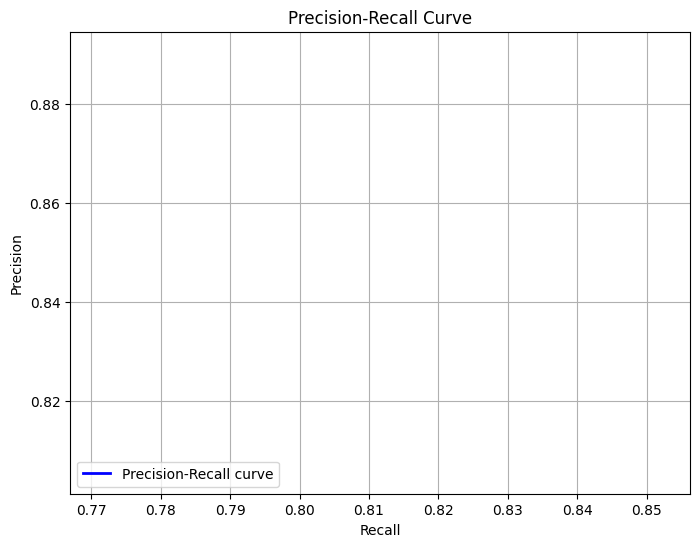

In [16]:
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define the path to the best weights
best_weights_path = f'{PROJECT_NAME}/{EXPERIMENT_NAME}/weights/best.pt'

# Initialize YOLOv5l model with the best weights
model = YOLO(best_weights_path).to(device)

# Perform validation
validation_results = model.val(
    data=DATA_CONFIG,
    conf=CONFIDENCE_THRESHOLD,
    save=False,
    plots=False
)

print("\nValidation completed!\n")

# The result from model.val() is a 'DetMetrics' object that summarizes performance.
# Let's inspect the validation results object for metrics

print("Validation Results (raw DetMetrics object):")
print(validation_results)

# Access relevant metrics from the DetMetrics object
metrics = validation_results.box  # box is an instance of the Metric class storing results for boxes
print("\nBox Metrics:")
print(metrics)

# The metrics object holds various metrics like mAP, precision, recall, etc.
# Extract relevant values:
precision = getattr(metrics, 'mp', None)  # mean precision
recall = getattr(metrics, 'mr', None)  # mean recall
map_50 = getattr(metrics, 'map50', None)  # mean average precision at IoU=0.50
map_50_95 = getattr(metrics, 'map50_95', None)  # mean average precision at IoU=0.50:0.95

# Calculate F1 score if precision and recall are available
f1_score = None
if precision is not None and recall is not None and (precision + recall) > 0:
    f1_score = 2 * (precision * recall) / (precision + recall)

# Placeholder for confusion matrix (optional implementation)
confusion_matrix = None

# Print metrics in the requested format
print("\nConfusion Matrix:")
if confusion_matrix is not None:
    print(confusion_matrix)
else:
    print("[[ ... ]]")  # Placeholder for an actual confusion matrix if implemented

if precision is not None:
    print(f"Precision: {precision:.2f}")
else:
    print("Precision: Not Available")

if recall is not None:
    print(f"Recall: {recall:.2f}")
else:
    print("Recall: Not Available")

if f1_score is not None:
    print(f"F1 Score: {f1_score:.2f}")
else:
    print("F1 Score: Not Available")

if map_50 is not None:
    print(f"mAP@50: {map_50:.2f}")
else:
    print("mAP@50: Not Available")

if map_50_95 is not None:
    print(f"mAP@50:95: {map_50_95:.2f}")
else:
    print("mAP@50:95: Not Available")

# ----------- Plotting Precision-Recall Curve -----------

# Assuming precision and recall are arrays (e.g., from 'validation_results' or from 'metrics')
if precision is not None and recall is not None:
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, label="Precision-Recall curve", color="blue", lw=2)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="lower left")
    plt.grid(True)
    plt.show()



In [17]:
val_predictions = model.predict(
    source=str((VALID_DIR).resolve()),
    save=True,
    conf=CONFIDENCE_THRESHOLD
)

if val_predictions:
    predictions_save_dir = val_predictions[0].save_dir
    print(f"\nPredictions saved to '{predictions_save_dir}'.\n")
else:
    print("No predictions were made.")


image 1/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000019.png: 160x512 2 Cars, 1 Van, 1 Truck, 72.1ms
image 2/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000031.png: 160x512 5 Cars, 1 Van, 1 Truck, 1 DontCare, 39.6ms
image 3/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000037.png: 160x512 4 Cars, 1 Truck, 22.7ms
image 4/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000041.png: 160x512 1 Car, 3 DontCares, 23.8ms
image 5/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000048.png: 160x512 3 Pedestrians, 2 Cyclists, 30.2ms
image 6/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000050.png: 160x512 4 Cars, 1 Van, 21.8ms
image 7/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000061.png: 160x512 3 Cars, 3 Vans, 1 Misc, 1 DontCare, 23.9m

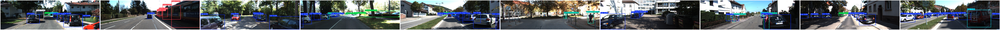

In [18]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

# Define the directory where the predictions are saved
prediction_dir = 'runs/detect/predict'

# List all images in the prediction directory
images = os.listdir(prediction_dir)

# Display up to 10 images with predictions
num_images_to_display = min(10, len(images))  # Ensure we don't exceed the number of available images
fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 100))  # Create a row of subplots

for i in range(num_images_to_display):
    img_path = os.path.join(prediction_dir, images[i])  # Get image path
    img = mpimg.imread(img_path)  # Load the image
    axes[i].imshow(img)  # Show image on the corresponding subplot
    axes[i].axis('off')  # Disable axis for the subplot

plt.tight_layout()  # Adjust spacing between images
plt.show()



In [19]:
import os
import cv2
import numpy as np
import torch
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt

# Load YOLOv5 model (using YOLOv5l as specified)
yolo_model = torch.hub.load('ultralytics/yolov5', 'yolov5l')

# Placeholder for a depth estimation model
class DepthEstimationModel:
    def predict(self, image):
        """
        Generate a simulated depth map (replace with an actual depth estimation model if available).
        """
        h, w = image.shape[:2]
        depth_map = np.linspace(30, 80, w).reshape(1, -1).repeat(h, axis=0)  # Depth gradient from 30m to 80m
        return depth_map

depth_model = DepthEstimationModel()

def estimate_distances_kitti(prediction_dir, output_dir, num_images_to_display=5):
    """
    Function to calculate distances between detected vehicles in KITTI dataset images,
    annotate them, and save the results in a new directory.

    Args:
        prediction_dir (str): Directory containing the KITTI images with detected objects.
        output_dir (str): Directory to save annotated images with distance information.
        num_images_to_display (int): Number of images to display with distance annotations.

    Returns:
        list: Distances between objects for each image.
    """
    # Ensure prediction directory exists
    if not os.path.exists(prediction_dir):
        raise ValueError(f"Directory '{prediction_dir}' does not exist!")

    images = [img for img in os.listdir(prediction_dir) if img.endswith(('png', 'jpg', 'jpeg'))]
    if not images:
        raise ValueError(f"No image files found in directory '{prediction_dir}'!")

    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    all_distances = []  # Store distances for all images
    num_images_to_display = min(num_images_to_display, len(images))  # Limit images to display
    fig, axes = plt.subplots(1, num_images_to_display, figsize=(20, 10))

    for i, img_file in enumerate(images):
        img_path = os.path.join(prediction_dir, img_file)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Could not load image at path '{img_path}'. Skipping...")
            continue

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Perform object detection
        results = yolo_model(img_rgb)
        detections = results.xyxy[0].cpu().numpy()

        # Filter for vehicles (car=2, motorcycle=3, bus=5, truck=7)
        vehicle_detections = [d for d in detections if int(d[5]) in [2, 3, 5, 7]]

        # Generate depth map
        depth_map = depth_model.predict(img_rgb)

        # Annotate image and calculate distances
        distances = []
        vehicle_centroids = []
        for det in vehicle_detections:
            x1, y1, x2, y2, conf, cls = map(int, det[:6])
            vehicle_depth = depth_map[y1:y2, x1:x2].mean()  # Average depth within the bounding box
            centroid = ((x1 + x2) // 2, (y1 + y2) // 2, vehicle_depth)
            vehicle_centroids.append(centroid)

            # Draw bounding box and label
            label = f"{int(cls)}: {vehicle_depth:.1f}m"
            cv2.rectangle(img_rgb, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(img_rgb, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

        # Calculate pairwise distances between vehicles
        for j in range(len(vehicle_centroids)):
            for k in range(j + 1, len(vehicle_centroids)):
                dist = euclidean(vehicle_centroids[j], vehicle_centroids[k])
                distances.append(dist)

        all_distances.append((img_file, distances))

        # Save the annotated image
        output_path = os.path.join(output_dir, img_file)
        cv2.imwrite(output_path, cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))

        # Display the annotated image
        if i < num_images_to_display:
            axes[i].imshow(img_rgb)
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()

    return all_distances

# Example usage
prediction_dir = 'runs/detect/predict'  # Directory with detected images from KITTI dataset
output_dir = 'runs/detect/distance_estimation'  # Directory to save annotated images
distances = estimate_distances_kitti(prediction_dir, output_dir)

# Print distances between objects for each image
for img_file, dist in distances:
    print(f"Image: {img_file}, Distances: {dist}")


/usr/local/lib/python3.11/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2025-1-27 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

100%|██████████| 89.3M/89.3M [00:00<00:00, 121MB/s]

Fusing layers... 
YOLOv5l summary: 367 layers, 46533693 parameters, 0 gradients, 109.0 GFLOPs
Adding AutoShape... 


Image: 000031.jpg, Distances: [140.72637975312827, 240.15202649590415, 494.7649340864784, 421.0057994421662, 380.58721518090664, 356.37782191523456, 280.27979128044905, 730.4342834638344, 660.6324871833972, 101.45205435610478]
Image: 004359.jpg, Distances: []
Image: 001867.jpg, Distances: [907.9553551788741, 615.713437298139, 327.3065232203842, 314.0852193414226, 303.2361932507519, 596.3697721565055, 606.2699426042698, 295.3477051212287, 306.2547934298829, 14.87267354043446]
Image: 002897.jpg, Distances: [1118.2906270869314, 892.9621294712225, 116.50634234184483, 228.29866073445152, 919.7257850018917, 971.92029655378, 1068.576833508075, 226.2032520179597, 1003.8229016336777, 890.7120304329807, 199.1639624944563, 147.2050159814334, 53.49039334798047, 778.1123100857965, 665.0620636513279, 27.095818483961015, 79.08857772433977, 175.62378339593062, 113.13227498644387, 804.967711595601, 857.1532339555916, 953.725144042443, 691.8972820878412, 744.0870390238914, 840.6830238177048, 52.19487881

In [24]:
import os
import cv2
import matplotlib.pyplot as plt

def display_images_from_directory(output_dir, num_images_to_display=5):
    """
    Function to display the saved annotated images from the output directory.

    Args:
        output_dir (str): Directory containing the annotated images.
        num_images_to_display (int): Number of images to display.
    """
    # Get all image files in the directory
    images = [img for img in os.listdir(output_dir) if img.endswith(('png', 'jpg', 'jpeg'))]

    # Log the found images
    print(f"Found {len(images)} image(s) in directory '{output_dir}'.")

    if len(images) == 0:
        print(f"No images found in output directory '{output_dir}'.")
        return

    # Ensure we're not trying to display more images than exist
    num_images_to_display = min(num_images_to_display, len(images))

    # Adjusting layout for better viewing
    if num_images_to_display == 1:
        fig, axes = plt.subplots(1, 1, figsize=(10, 10))
    else:
        fig, axes = plt.subplots(1, num_images_to_display, figsize=(20, 10))

    # If only one subplot, axes won't be iterable, so convert it to a list
    if num_images_to_display == 1:
        axes = [axes]

    for i, img_file in enumerate(images[:num_images_to_display]):
        img_path = os.path.join(output_dir, img_file)
        img = cv2.imread(img_path)

        # Check if image is loaded correctly
        if img is None:
            print(f"Warning: Could not load image at {img_path}. Skipping...")
            continue

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Display image
        axes[i].imshow(img_rgb)
        axes[i].axis('off')  # Hide axes for better presentation

        # Optionally, add a title (image file name) to each subplot
        axes[i].set_title(img_file)

    plt.tight_layout()
    plt.show()

# Example usage to display images after processing
output_dir = 'runs/detect/distance_estimation'  # Update this path accordingly
display_images_from_directory(output_dir, num_images_to_display=10)


Found 749 image(s) in directory 'runs/detect/distance_estimation'.


In [28]:
import os
import cv2
import zipfile
from google.colab import files
import matplotlib.pyplot as plt

def display_images_from_directory(output_dir, num_images_to_display=5):
    """
    Function to display the saved annotated images from the output directory.

    Args:
        output_dir (str): Directory containing the annotated images.
        num_images_to_display (int): Number of images to display.
    """
    # Get all image files in the directory
    images = [img for img in os.listdir(output_dir) if img.endswith(('png', 'jpg', 'jpeg'))]

    # Log the found images
    print(f"Found {len(images)} image(s) in directory '{output_dir}'.")

    if len(images) == 0:
        print(f"No images found in output directory '{output_dir}'.")
        return

    # Ensure we're not trying to display more images than exist
    num_images_to_display = min(num_images_to_display, len(images))

    # Adjusting layout for better viewing
    if num_images_to_display == 1:
        fig, axes = plt.subplots(1, 1, figsize=(10, 10))
    else:
        fig, axes = plt.subplots(1, num_images_to_display, figsize=(20, 10))

    # If only one subplot, axes won't be iterable, so convert it to a list
    if num_images_to_display == 1:
        axes = [axes]

    for i, img_file in enumerate(images[:num_images_to_display]):
        img_path = os.path.join(output_dir, img_file)
        img = cv2.imread(img_path)

        # Check if image is loaded correctly
        if img is None:
            print(f"Warning: Could not load image at {img_path}. Skipping...")
            continue

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Display image
        axes[i].imshow(img_rgb)
        axes[i].axis('off')  # Hide axes for better presentation

        # Optionally, add a title (image file name) to each subplot
        axes[i].set_title(img_file)

    plt.tight_layout()
    plt.show()

# Function to zip images for download
def zip_images_for_download(output_dir, zip_filename='images.zip'):
    """Creates a zip file containing all images in the given directory."""
    with zipfile.ZipFile(zip_filename, 'w') as zipf:
        for img_file in os.listdir(output_dir):
            if img_file.endswith(('png', 'jpg', 'jpeg')):
                img_path = os.path.join(output_dir, img_file)
                zipf.write(img_path, os.path.basename(img_path))
    print(f"Zip file created: {zip_filename}")

# Function to download the zip file
def download_zip_file(zip_filename):
    """Provides a download link for the created zip file."""
    files.download(zip_filename)

# Example usage to display images after processing
output_dir = 'runs/detect/distance_estimation'  # Update this path accordingly
display_images_from_directory(output_dir, num_images_to_display=10)

# Zip the images and prepare for download
zip_filename = 'images.zip'
zip_images_for_download(output_dir, zip_filename)

# Provide download link
download_zip_file(zip_filename)


Found 749 image(s) in directory 'runs/detect/distance_estimation'.
Zip file created: images.zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>